# Chron.jl coupled eruption/deposition age and age-depth model Schoene et al., 2019

In [1]:
# Load (and install if necessary) the Chron.jl package
using Chron
using Plots, DelimitedFiles


# Load sample code and elevation

In [2]:
nSamples = 24 # The number of samples you have data for
smpl = ChronAgeData(nSamples)

smpl.Name = (
    "RBG", "DEC13-09", "RBF", "RBE", "RBO", "RBP",
    "RBAN", "RBAO", "RBAY", "RBB2", "RBBF", "RBBH",
    "RBX", "RBAW", "RBBS", "RBBJ", "RBBR", "RBBM",
    "RBBI", "RBBL", "RBBQ", "RBAG", "RBAB", "DEC13-30",
)

smpl.Height .= [
    1190.0,   # RBG
    1088.0,   # DEC13-09
    1064.0,   # RBF
    999.0,    # RBE
    1176.0,   # RBO
    1083.0,   # RBP
    701.0,    # RBAN
    1176.0,   # RBAO
    783.0,    # RBAY
    659.0,    # RBB2
    1064.0,   # RBBF
    747.0,    # RBBH
    390.0,    # RBX
    681.0,    # RBAW
    628.0,    # RBBS
    684.0,    # RBBJ
    602.0,    # RBBR
    701.0,    # RBBM
    651.0,    # RBBI
    644.0,    # RBBL
    572.0,    # RBBQ
    687.0,    # RBAG
    718.0,    # RBAB
    255.0     # DEC13-30
]


smpl.Height_sigma .= [
    10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0,
    10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0, 10.0,
]

smpl.Height_sigma .= [
    0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
    0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
]



smpl
smpl.Age_Sidedness .= zeros(nSamples) # Sidedness (zeros by default: geochron constraints are two-sided). Use -1 for a maximum age and +1 for a minimum age, 0 for two-sided
smpl.Path = "age_excel_data_Orginal_code_1_cell_schoence_2019_science/" # Where are the data files? Must match where you put the csv files below.
smpl.inputSigmaLevel = 2 # i.e., are the data files 1-sigma or 2-sigma. Integer.

smpl.Age_Unit = "Ma" # Unit of measurement for ages and errors in the data files
smpl.Height_Unit = "m"; # Unit of measurement for Height and Height_sigma

# Bootstrap a KDE of the pre-eruptive (or pre-deposition) zircon distribution

┌ Info: Interpreting first two columns of RBG.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of DEC13-09.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBF.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBE.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBO.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBP.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBAN.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBAO.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBAY.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBB2.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting first two columns of RBBF.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: Interpreting f

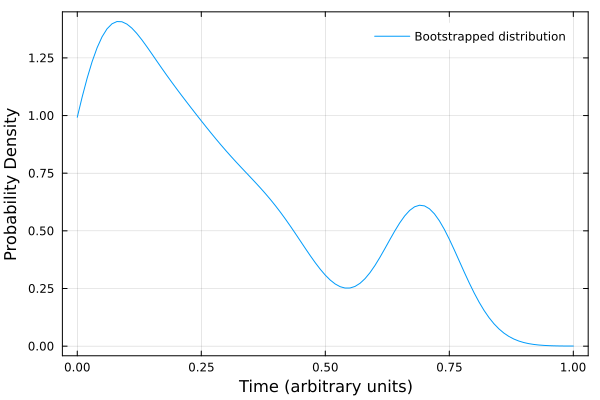

In [3]:
# shape from individual sample datafiles using a KDE of stacked sample data
BootstrappedDistribution = BootstrapCrystDistributionKDE(smpl)
h = plot(range(0,1,length=length(BootstrappedDistribution)), BootstrappedDistribution,
    label="Bootstrapped distribution", xlabel="Time (arbitrary units)", ylabel="Probability Density", 
    fg_color_legend=:white, framestyle=:box)
savefig(h, joinpath(smpl.Path,"BootstrappedDistribution.pdf"))
display(h)

# Run eruption/deposition age model

In [4]:
# Number of steps to run in distribution MCMC
distSteps = 10^6
distBurnin = distSteps÷100

# Choose the form of the prior closure/crystallization distribution to use
dist = BootstrappedDistribution
## You might alternatively consider:
# dist = UniformDistribution              # A reasonable default
# dist = MeltsVolcanicZirconDistribution  # A single magmatic pulse, truncated by eruption
# dist = ExponentialDistribution          # Applicable for survivorship processes, potentially including inheritance/dispersion in Ar-Ar dates

# Run MCMC to estimate saturation and eruption/deposition age distributions
smpl = tMinDistMetropolis(smpl,distSteps,distBurnin,dist)
results = vcat(["Sample" "Age" "2.5% CI" "97.5% CI" "sigma"], hcat(collect(smpl.Name),smpl.Age,smpl.Age_025CI,smpl.Age_975CI,smpl.Age_sigma))
writedlm(joinpath(smpl.Path,"results.csv"), results, ',');

[ Info: Estimating eruption/deposition age distributions...
┌ Info: 1: RBG
│ Interpreting first two columns of RBG.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 2: DEC13-09
│ Interpreting first two columns of DEC13-09.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 3: RBF
│ Interpreting first two columns of RBF.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 4: RBE
│ Interpreting first two columns of RBE.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 5: RBO
│ Interpreting first two columns of RBO.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 6: RBP
│ Interpreting first two columns of RBP.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 7: RBAN
│ Interpreting first two columns of RBAN.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 8: RBAO
│ Interpreting first two columns of RBAO.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 9: RBAY
│ Interpreting first two columns of RBAY.csv as 
└  | Age | Age 2-sigma 𝑎𝑏𝑠𝑜𝑙𝑢𝑡𝑒 |
┌ Info: 10: RBB2
│ Interpreting first two columns o

## Configure and run stratigraphic model

[ Info: Generating stratigraphic age-depth model...
[ Info: Burn-in: 37440000 steps
Burn-in... 100%|█████████████████████████████████████████| Time: 0:00:27
[ Info: Collecting sieved stationary distribution: 56160000 steps
Collecting... 100%|██████████████████████████████████████| Time: 0:00:40


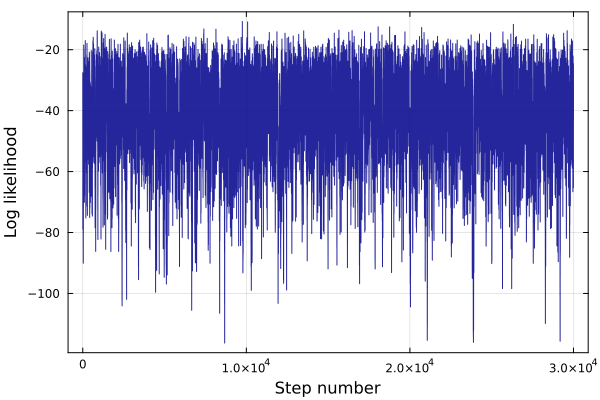

In [6]:
# Configure the stratigraphic Monte Carlo model
config = StratAgeModelConfiguration()
# If you in doubt, you can probably leave these parameters as-is
config.resolution = 1.0 # Same units as sample height. Smaller is slower!
config.bounding = 0.5 # how far away do we place runaway bounds, as a fraction of total section height
(bottom, top) = extrema(smpl.Height)
npoints_approx = round(Int,length(bottom:config.resolution:top) * (1 + 2*config.bounding))
config.nsteps = 30000 # Number of steps to run in distribution MCMC
config.burnin = 20000*npoints_approx # Number to discard
config.sieve = round(Int,npoints_approx) # Record one out of every nsieve steps

# Run the stratigraphic MCMC model
(mdl, agedist, lldist) = StratMetropolisDist(smpl, config); sleep(0.5)

# Plot the log likelihood to make sure we're converged (n.b burnin isn't recorded)
plot(lldist,xlabel="Step number",ylabel="Log likelihood",label="",line=(0.85,:darkblue), framestyle=:box)

The most important output of this process is `agedist`, which contains the full stationary distribution of the age-depth model. We can save it to a file, but if this notebook is running remotely, you may have trouble getting it out of here (see section **Getting your data out**)!

In [8]:
writedlm(joinpath(smpl.Path,"agedist.csv"), agedist, ',') # Stationary distribution of the age-depth model
writedlm(joinpath(smpl.Path,"height.csv"), mdl.Height, ',') # Stratigraphic heights corresponding to each row of agedist
writedlm(joinpath(smpl.Path,"lldist.csv"), lldist, ',') # Log likelihood distribution (to check for stationarity)

***
## Plot results (Height vs Age)

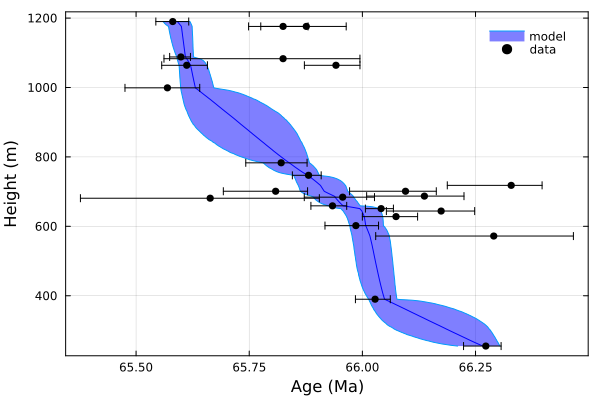

In [7]:
# Plot results (mean and 95% confidence interval for both model and data)
hdl = plot([mdl.Age_025CI; reverse(mdl.Age_975CI)],[mdl.Height; reverse(mdl.Height)], fill=(round(Int,minimum(mdl.Height)),0.5,:blue), label="model")
plot!(hdl, mdl.Age, mdl.Height, linecolor=:blue, label="", fg_color_legend=:white) # Center line
t = smpl.Age_Sidedness .== 0 # Two-sided constraints (plot in black)
any(t) && plot!(hdl, smpl.Age[t], smpl.Height[t], xerror=(smpl.Age[t]-smpl.Age_025CI[t],smpl.Age_975CI[t]-smpl.Age[t]),label="data",seriestype=:scatter,color=:black)
t = smpl.Age_Sidedness .== 1 # Minimum ages (plot in cyan)
any(t) && plot!(hdl, smpl.Age[t], smpl.Height[t], xerror=(smpl.Age[t]-smpl.Age_025CI[t],zeros(count(t))),label="",seriestype=:scatter,color=:cyan,msc=:cyan)
any(t) && zip(smpl.Age[t], smpl.Age[t].+nanmean(smpl.Age_sigma[t])*4, smpl.Height[t]) .|> x-> plot!([x[1],x[2]],[x[3],x[3]], arrow=true, label="", color=:cyan)
t = smpl.Age_Sidedness .== -1 # Maximum ages (plot in orange)
any(t) && plot!(hdl, smpl.Age[t], smpl.Height[t], xerror=(zeros(count(t)),smpl.Age_975CI[t]-smpl.Age[t]),label="",seriestype=:scatter,color=:orange,msc=:orange)
any(t) && zip(smpl.Age[t], smpl.Age[t].-nanmean(smpl.Age_sigma[t])*4, smpl.Height[t]) .|> x-> plot!([x[1],x[2]],[x[3],x[3]], arrow=true, label="", color=:orange)
plot!(hdl, xlabel="Age ($(smpl.Age_Unit))", ylabel="Height ($(smpl.Height_Unit))", framestyle=:box)
savefig(hdl,joinpath(smpl.Path,"AgeDepthModel.svg"))
savefig(hdl,joinpath(smpl.Path,"AgeDepthModel.pdf"))
display(hdl)

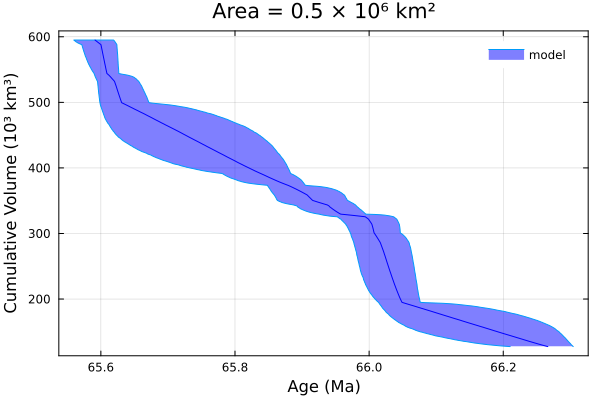

In [8]:
# Define area in km² and convert to m²
area_km2 = 500000          # e.g., 0.5 million km²
area_m2 = area_km2 * 1e6   # in m²

# Calculate volumes in km³
mdl_Volume = mdl.Height .* area_m2 ./ 1e9
mdl_Volume_025CI = mdl.Height .* area_m2 ./ 1e9
mdl_Volume_975CI = mdl.Height .* area_m2 ./ 1e9
smpl_Volume = smpl.Height .* area_m2 ./ 1e9

# Convert to 10³ km³ (i.e., thousands of km³)
volume_thousands = mdl_Volume ./ 1000

# Dynamically format area in 1e6 km²
area_1e6 = area_km2 / 1e6   # e.g., 0.5
title_str = "Area = $(area_1e6) × 10⁶ km²"
file_title = "AgeDepth_model$(title_str)"

# Plot volume envelope
hdl = plot(
    [mdl.Age_025CI; reverse(mdl.Age_975CI)],
    [volume_thousands; reverse(volume_thousands)],
    fill = (round(Int, minimum(volume_thousands)), 0.5, :blue),
    label = "model"
)

# Plot model volume line
plot!(
    hdl, mdl.Age, volume_thousands,
    linecolor = :blue,
    label = "",
    fg_color_legend = :white
)

# Label axes and set title
plot!(
    hdl,
    xlabel = "Age (Ma)",
    ylabel = "Cumulative Volume (10³ km³)",
    title = title_str,
    framestyle = :box
)

# Save with dynamic file name
savefig(hdl, joinpath(smpl.Path, "$file_title.svg"))
savefig(hdl, joinpath(smpl.Path, "$file_title.pdf"))

# Display
display(hdl)


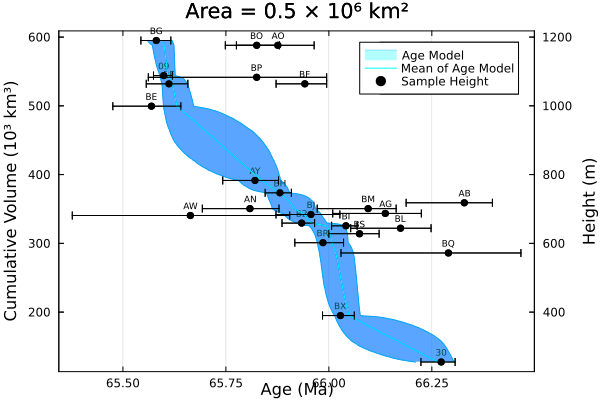

In [52]:
using Statistics
using Plots

# Extract last two letters of sample names into a separate array
short_names = [last(name, 2) for name in smpl.Name]

# Define area & convert to m²
area_km2 = 500000
area_m2 = area_km2 * 1e6

# Calculate volumes in km³ and convert to thousands km³
mdl_Volume = mdl.Height .* area_m2 ./ 1e9
volume_thousands = mdl_Volume ./ 1000
smpl_Volume = smpl.Height .* area_m2 ./ 1e9 ./ 1000

# Dynamic title string
area_1e6 = area_km2 / 1e6
title_str = "Area = $(area_1e6) × 10⁶ km²"
file_title = "AgeDepth_model$(title_str)"

# --- Start plotting Cumulative Volume (left axis) with confidence interval envelope ---
hdl = plot(
    [mdl.Age_025CI; reverse(mdl.Age_975CI)],
    [volume_thousands; reverse(volume_thousands)],
    fill = (round(Int, minimum(volume_thousands)), 0.5, :blue),
    label = "Model Volume"
)

# Plot model mean line for volume
plot!(hdl, mdl.Age, volume_thousands, linecolor = :blue, label = "Volume")

# Two-sided constraints indices
t = smpl.Age_Sidedness .== 0
indices = findall(t)

# Plot sample data volume with age error bars (two-sided black)
if !isempty(indices)
    plot!(
        hdl, smpl.Age[indices], smpl_Volume[indices],
        xerror = (smpl.Age[indices] .- smpl.Age_025CI[indices], smpl.Age_975CI[indices] .- smpl.Age[indices]),
        seriestype = :scatter, color = :black, label = "Sample Volume"
    )
    # Vertical offset for volume label annotations
    y_offset_volume = 0.03 * (maximum(volume_thousands) - minimum(volume_thousands))
    # Annotate volume points slightly above scatter points with smaller font size
    annotate!(hdl, [(smpl.Age[i], smpl_Volume[i] + y_offset_volume, text(short_names[i], 6)) for i in indices]...)
end

# --- Add second y-axis for Height using twinx ---
hdl2 = twinx(hdl)

# Plot model height confidence interval envelope (light blue fill)
plot!(
    hdl2,
    [mdl.Age_025CI; reverse(mdl.Age_975CI)],
    [mdl.Height; reverse(mdl.Height)],
    fill = (round(Int, minimum(mdl.Height)), 0.3, :cyan),
    alpha = 0.3,
    label = "Age Model"
)

# Model mean height line
plot!(hdl2, mdl.Age, mdl.Height, linecolor = :cyan, label = "Mean of Age Model")

# Plot sample height with age error bars in black (two-sided)
if !isempty(indices)
    plot!(
        hdl2, smpl.Age[indices], smpl.Height[indices],
        xerror = (smpl.Age[indices] .- smpl.Age_025CI[indices], smpl.Age_975CI[indices] .- smpl.Age[indices]),
        seriestype = :scatter, color = :black, markerstrokecolor = :black, label = "Sample Height"
    )
    # Vertical offset for height label annotations
    y_offset_height = 0.02 * (maximum(mdl.Height) - minimum(mdl.Height))
    offset = 0.5  # horizontal offset as before
    # Annotate height points slightly above scatter points with smaller font size
    # annotate!(hdl2, [(smpl.Age[i] + offset, smpl.Height[i] + y_offset_height, text(short_names[i], 6)) for i in indices]...)
end

# --- Labels & titles ---
plot!(
    hdl,
    
    ylabel = "Cumulative Volume (10³ km³)",
    title = title_str,
    framestyle = :box
)

# Disable x-axis label on secondary axis to avoid duplication
plot!(hdl2, ylabel = "Height (m)", framestyle = :box, xlabel = "Age (Ma)")

# Save figure
savefig(hdl, joinpath(smpl.Path, "$file_title.svg"))
savefig(hdl, joinpath(smpl.Path, "$file_title.pdf"))

# Display plot
display(hdl)


Interpolated age: 66.72743780821838 +-0.2978989284893032/--1.1926160891634936 Ma

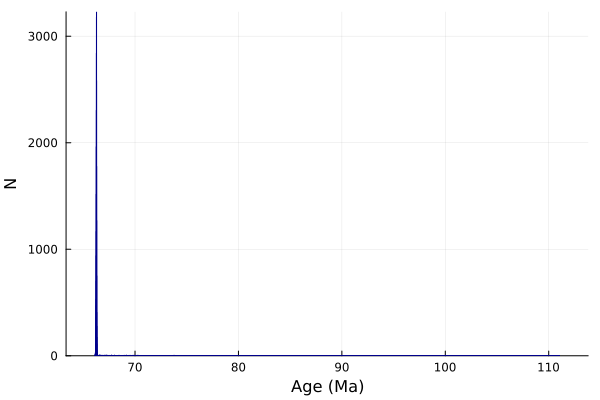

In [54]:
# Interpolate results at a given height
height = 0

interpolated_age = linterp1s(mdl.Height,mdl.Age,height)
interpolated_age_min = linterp1s(mdl.Height,mdl.Age_025CI,height)
interpolated_age_max = linterp1s(mdl.Height,mdl.Age_975CI,height)
print("Interpolated age: $interpolated_age +$(interpolated_age_max-interpolated_age)/-$(interpolated_age-interpolated_age_min) Ma")

# We can also interpolate the full distribution:
interpolated_distribution = Array{Float64}(undef,size(agedist,2))
for i=1:size(agedist,2)
    interpolated_distribution[i] = linterp1s(mdl.Height,agedist[:,i],height)
end
histogram(interpolated_distribution, xlabel="Age ($(smpl.Age_Unit))", ylabel="N", label="", fill=(0.75,:darkblue), linecolor=:darkblue)

# Eruption rate m/Ma

  1.942276 seconds (1.07 M allocations: 8.150 GiB, 11.91% gc time, 5.77% compilation time)


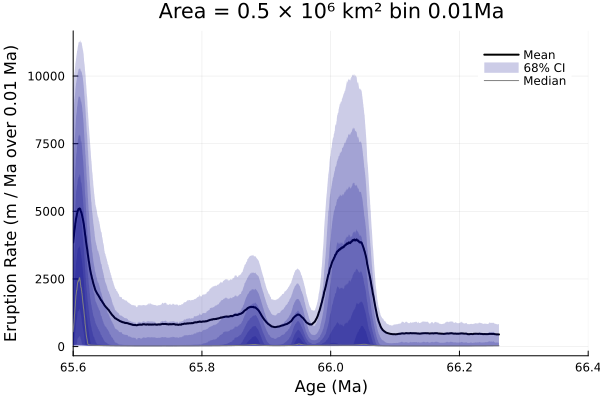

In [56]:
# Set bin width and spacing
binwidth = round(nanrange(mdl.Age)/10,sigdigits=1) # Can also set manually, commented out below
binwidth = 0.01 # Same units as smpl.Age, 0.001 meaning 1000 year, 0.01 meaning 10,000 year
binoverlap = 100

# Dynamically format area in 1e6 km²
area_1e6 = area_km2 / 1e6   # e.g., 0.5
title_str = "Area = $(area_1e6) × 10⁶ km² bin $(binwidth)Ma"
file_title = "Eruption_Rate_$(title_str)_per_Ma_over"

agebinedges = collect(minimum(mdl.Age):binwidth/binoverlap:maximum(mdl.Age))
agebincenters = (agebinedges[1:end-binoverlap] + agebinedges[1+binoverlap:end])/2

# Calculate rates for the stratigraphy of each markov chain step
dhdt_dist = zeros(length(agebincenters), config.nsteps)
@time for i=1:config.nsteps
    heights = linterp1(reverse(agedist[:,i]), reverse(mdl.Height), agebinedges, extrapolate=NaN)
    dhdt_dist[:,i] .= (heights[1:end-binoverlap] - heights[binoverlap+1:end]) ./ binwidth
end

# Find mean and 1-sigma (68%) CI
dhdt = nanmean(dhdt_dist,dim=2)
dhdt_50p = nanmedian(dhdt_dist,dim=2)
dhdt_16p = nanpctile(dhdt_dist,15.865,dim=2) # Minus 1-sigma (15.865th percentile)
dhdt_84p = nanpctile(dhdt_dist,84.135,dim=2) # Plus 1-sigma (84.135th percentile)

# Plot results
hdl = plot(agebincenters,dhdt, label="Mean", color=:black, linewidth=2)
plot!(hdl,[agebincenters; reverse(agebincenters)],[dhdt_16p; reverse(dhdt_84p)], fill=(0,0.2,:darkblue), linealpha=0, label="68% CI")
for lci in 20:5:45
    dhdt_lp = nanpctile(dhdt_dist,lci,dim=2)
    dhdt_up = nanpctile(dhdt_dist,100-lci,dim=2)
    plot!(hdl,[agebincenters; reverse(agebincenters)],[dhdt_lp; reverse(dhdt_up)], fill=(0,0.2,:darkblue), linealpha=0, label="")
end
plot!(hdl, agebincenters,dhdt_50p, label="Median", color=:grey, linewidth=1)
plot!(hdl, xlabel="Age ($(smpl.Age_Unit))", ylabel="Eruption Rate ($(smpl.Height_Unit) / $(smpl.Age_Unit) over $binwidth $(smpl.Age_Unit))", title = title_str,fg_color_legend=:white)
# Set x-axis limits here
xlims!(hdl, (65.6, 66.4))  # <-- ADD THIS LINE
savefig(hdl, joinpath(smpl.Path, "$file_title.pdf"))
savefig(hdl, joinpath(smpl.Path, "$file_title.svg"))
display(hdl)

In [ ]:
# Area normalised cumulative volume

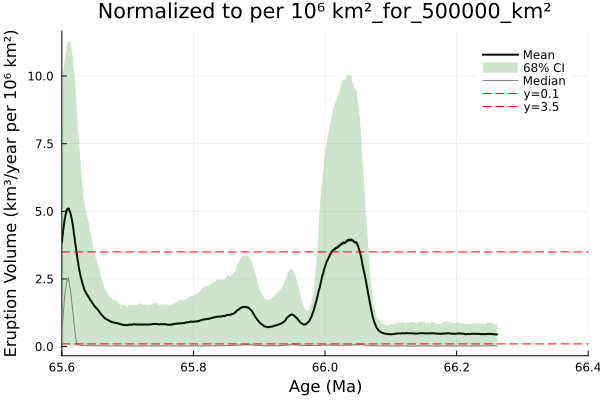

In [57]:
# Normalised # Constants
years_per_Ma = 1e6

# --- Normalization ---
orig_area_km2 = 500000         # Original area for reference
norm_area_mkm2 = orig_area_km2 / 1e6  # in million km²

# Convert rates to km³/year per million km²
volume_dist_km3_per_year = (
    dhdt_dist ./ years_per_Ma .* (orig_area_km2 * 1e6) ./ 1e9
) ./ norm_area_mkm2

# Mean and confidence intervals
volume_km3_per_year = nanmean(volume_dist_km3_per_year, dims=2)
volume_50p           = nanmedian(volume_dist_km3_per_year, dims=2)
volume_16p           = nanpctile(volume_dist_km3_per_year, 15.865, dims=2)
volume_84p           = nanpctile(volume_dist_km3_per_year, 84.135, dims=2)

# Title now reflects normalization
title_str = "Normalized to per 10⁶ km²_for_$(orig_area_km2)_km²"
file_title = "Normalised_Area_$(orig_area_km2)_km2_Eruption_Rate_per_Ma_per_1e6km2_over_$(binwidth)Ma"

hdl = plot(agebincenters, volume_km3_per_year, label="Mean", color=:black, linewidth=2)
plot!(hdl,
      [agebincenters; reverse(agebincenters)],
      [volume_16p; reverse(volume_84p)],
      fill=(0, 0.2, :green), linealpha=0, label="68% CI")
plot!(hdl, agebincenters, volume_50p, label="Median", color=:grey, linewidth=1)

plot!(hdl,
      xlabel="Age ($(smpl.Age_Unit))",
      ylabel="Eruption Volume (km³/year per 10⁶ km²)",
      title = title_str,
      fg_color_legend=:white
    
      )

hline!([0.1], linestyle=:dash, color=:red, label="y=0.1")
hline!([3.5], linestyle=:dash, color=:red, label="y=3.5")
xlims!(hdl, (65.6, 66.4))

savefig(hdl, joinpath(smpl.Path, "$file_title.pdf"))
savefig(hdl, joinpath(smpl.Path, "$file_title.svg"))
display(hdl)
